In [1]:
%env ALL_PROXY=http://192.168.12.100:7890
%env HTTP_PROXY=http://192.168.12.100:7890
%env HTTPS_PROXY=http://192.168.12.100:7890
import stt as st
import scanpy as sc
import cellrank as cr
adata = cr.datasets.pancreas()

env: ALL_PROXY=http://192.168.12.100:7890
env: HTTP_PROXY=http://192.168.12.100:7890
env: HTTPS_PROXY=http://192.168.12.100:7890


/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


In [2]:
import scvelo as scv
scv.pp.filter_and_normalize(
    adata, min_shared_counts=20, n_top_genes=2000
)

Filtered out 22024 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


In [3]:
scv.pp.moments(adata)

computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [4]:
adata.obs['attractor']=adata.obs['clusters']
adata_aggr = st.tl.dynamical_iteration(adata,n_states =8, n_iter = 20, n_neighbors = 25, n_components = 21, weight_connectivities=0.5, monitor_mode=False)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000040e+00 -6.8693292013377420e-03 2.4959649106280433e-03 -5.4663243218511541e-03 1.4255484871861557e-02 -2.5483831369608580e-03 9.3749067409332181e-03 1.1026665614557144e-02 9.2155773774925953e-03 2.8717021333468269e-03 -2.7161311810092816e-02 1.1010312190516893e-02 1.1124657278043284e-02 -2.5858118279592043e-02 -2.9265803826974857e-02 2.3872456315935670e-02 -2.3446107597167910e-02 2.4108498411813357e-02 6.9017779609653621e-02 6.9402346679030891e-02 1.9306268577359391e-02 2.6358673585852224e-03 
0.0000000000000000e+00 9.8528428850967031e-01 -2.0266211333744195e-02 1.6792407612980503e-04 6.1572107187425086e-04 -1.5794249966228538e-03 8.1515487760419753e-03 -1.5995164025089333e-02 -6.1928845303815417e-03 -1.2344604785997068e-02 -6.6567043167345885e-04 -1.9510941773159353e-02 -2.0426394972724049e-03 -2.8867388899333881e-03 1.5344796505559742e-02 -2.4494290818103597e-02 1.2505359998045874e-02 -1.4347843432934619e-02 -3.6282046068115

/home/bingsanyu/1WORK/cwj/STT-release/example_notebooks/stt/tl/_dynamical_analysis.py:373: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sc_object_aggr.obs['entropy'] = adata.obs['entropy'].values


In [5]:
sc.set_figure_params(dpi=600,fontsize = 12)
sc.pl.embedding(adata,color = ['clusters','attractor','speed','entropy'],basis = 'umap',legend_fontsize = 10)

In [6]:
adata_aggr.obsm['X_umap'] = adata.obsm['X_umap']
scv.tl.velocity_graph(adata_aggr,n_jobs=-1,vkey = 'vj')

computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

    finished (0:00:05) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)


/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)


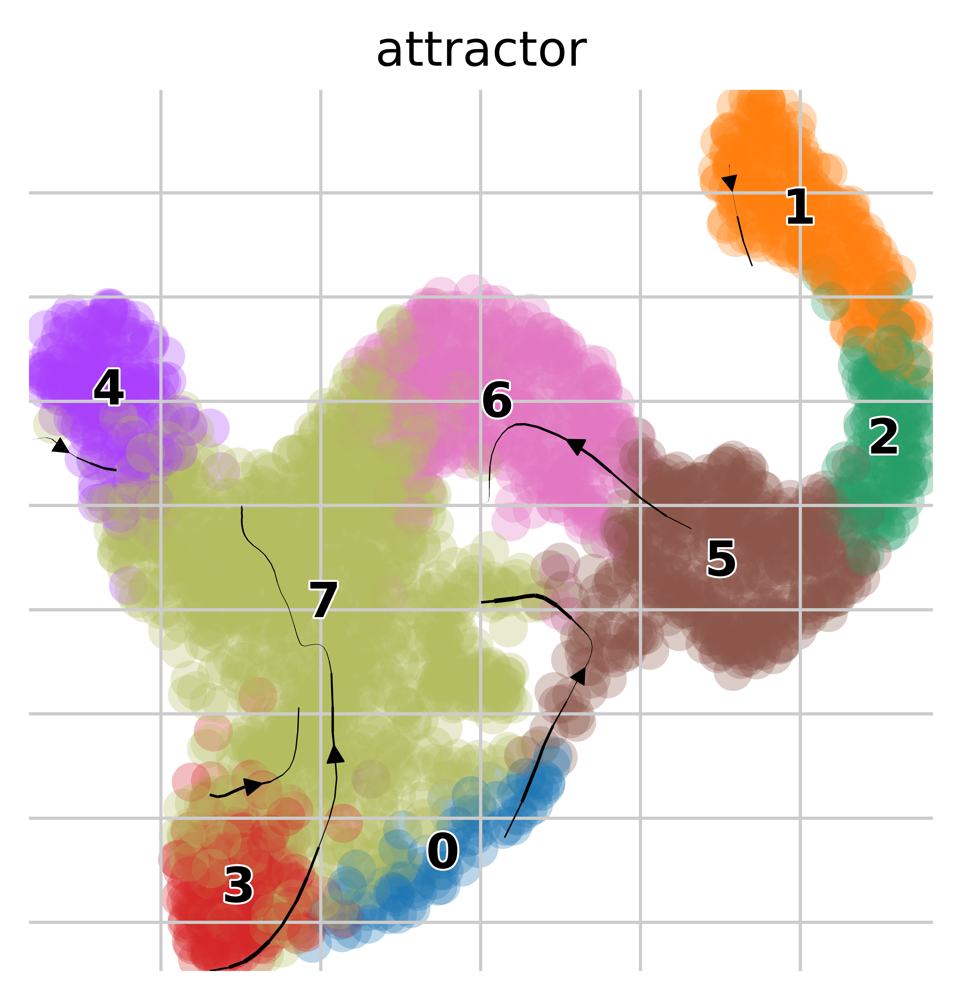

In [7]:
scv.pl.velocity_embedding_stream(adata_aggr, basis='umap', color='attractor',vkey = 'vj',density = 0.2)

In [8]:
import matplotlib.pyplot as plt
sc.set_figure_params(dpi=600,fontsize = 10)
adata.obsm['X_umap_aggr']=adata_aggr.obsm['X_umap']
st.pl.plot_tensor(adata, adata_aggr, list_attractor = [0,1,4],basis = 'umap',filter_cells = True, member_thresh = 0.1, density = 0.5)
plt.savefig('pancreas_tensor.png')

check that the input includes aggregated object
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:06) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:06) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:06) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:19) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:19) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:13) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:20) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:04) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 16/16 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/home/bingsanyu/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:01:04) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)


  0%|          | 0/100 [00:00<?, ?sim/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


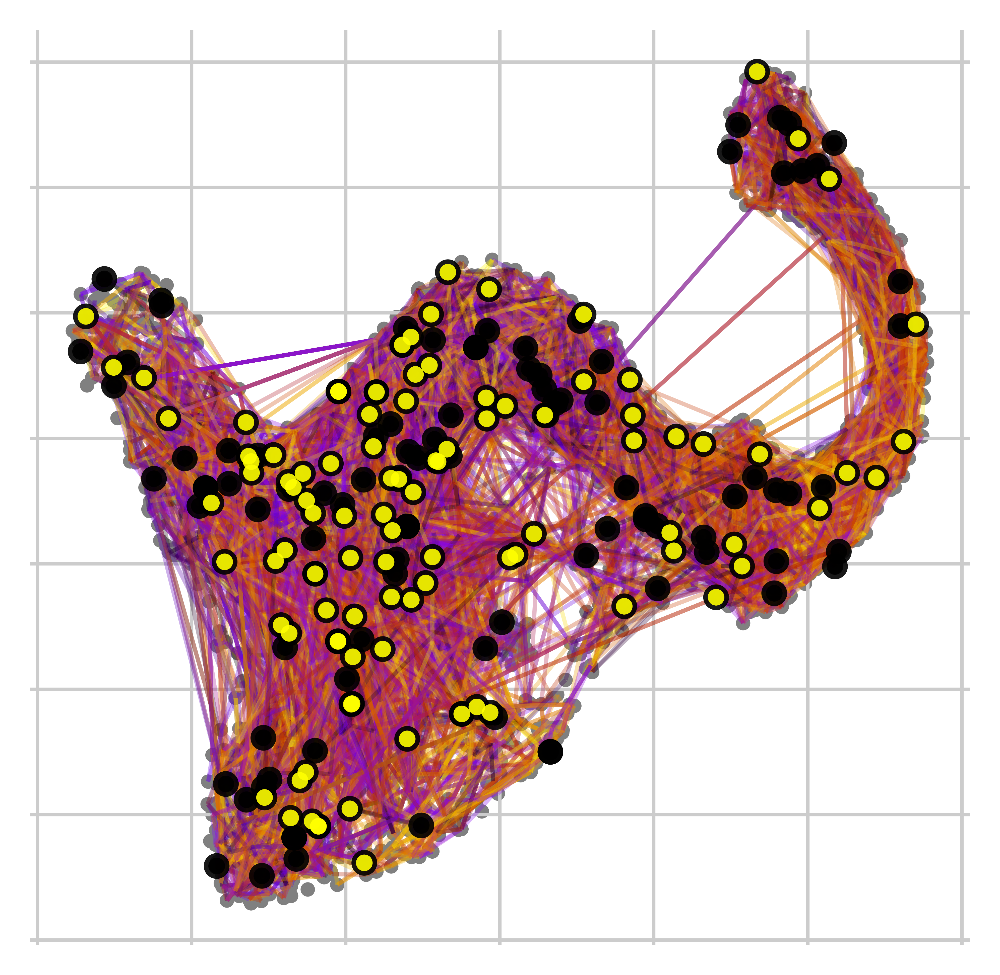

In [9]:
kernel = adata.uns['kernel']
kernel.adata.obsm['X_umap'] = adata_aggr.obsm['X_umap']
kernel.plot_random_walks(n_sims=100,basis='umap',max_iter=200,n_jobs=-1)

Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000029e+00 1.8490006842344830e-03 1.0050824499814011e-03 -4.0007417933297434e-03 -1.2501612969023385e-02 -7.5144041217042991e-03 2.3168412735256282e-02 -2.6778663849816278e-02 -2.7253327711025801e-04 
0.0000000000000000e+00 9.8542301970355384e-01 1.2291068877013919e-02 -8.6831032850827293e-03 -2.8370710671060326e-03 8.9287370849282493e-03 -1.8555540966303141e-03 -2.0523393566413160e-02 9.5445532024217676e-03 
0.0000000000000000e+00 0.0000000000000000e+00 9.5911277873342082e-01 1.7396565339457923e-02 -1.4301186269684843e-02 5.6640747176122377e-03 4.8760892361263972e-03 -1.1603329680749192e-02 2.7777831522555079e-03 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 9.1756656170260631e-01 9.3558212473189330e-03 7.0424128245472123e-03 -1.8313705570603474e-02 -9.1621773643799278e-03 -2.8364743851147728e-03 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 9.069944872624592

  0%|          | 0/240 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


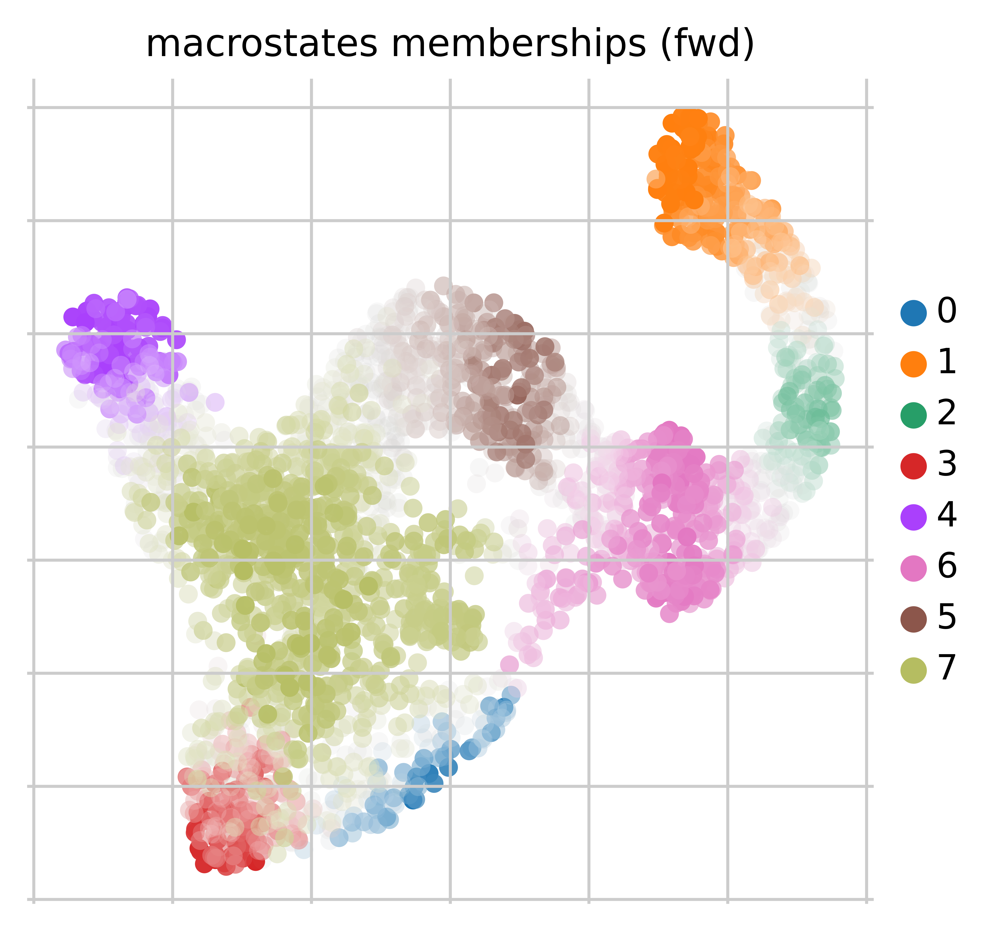

In [10]:
g = cr.tl.estimators.GPCCA(kernel)
g.fit(cluster_key="attractor",n_lineages = 8)
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

In [11]:
dir(g)

['_',
 '_G2M_score',
 '_S_score',
 '__abstractmethods__',
 '__class__',
 '__copy__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_abs_prob_key',
 '_absorption_probabilities',
 '_absorption_time_mean',
 '_absorption_time_var',
 '_check_states_validity',
 '_coarse_T',
 '_coarse_init_dist',
 '_coarse_stat_dist',
 '_compute_initial_states',
 '_compute_one_macrostate',
 '_create_states',
 '_detect_cc_stages',
 '_direction',
 '_eig',
 '_fit_terminal_states',
 '_g2m_key',
 '_get',
 '_get_n_states_from_minchi',
 '_gpcca',
 '_invalid_n_states',
 '_is_irreducible',
 '_kernel',
 '_key_added',
 '_lin_abs_times',
 '_lin_drivers',
 '_macrostates',
 '_m

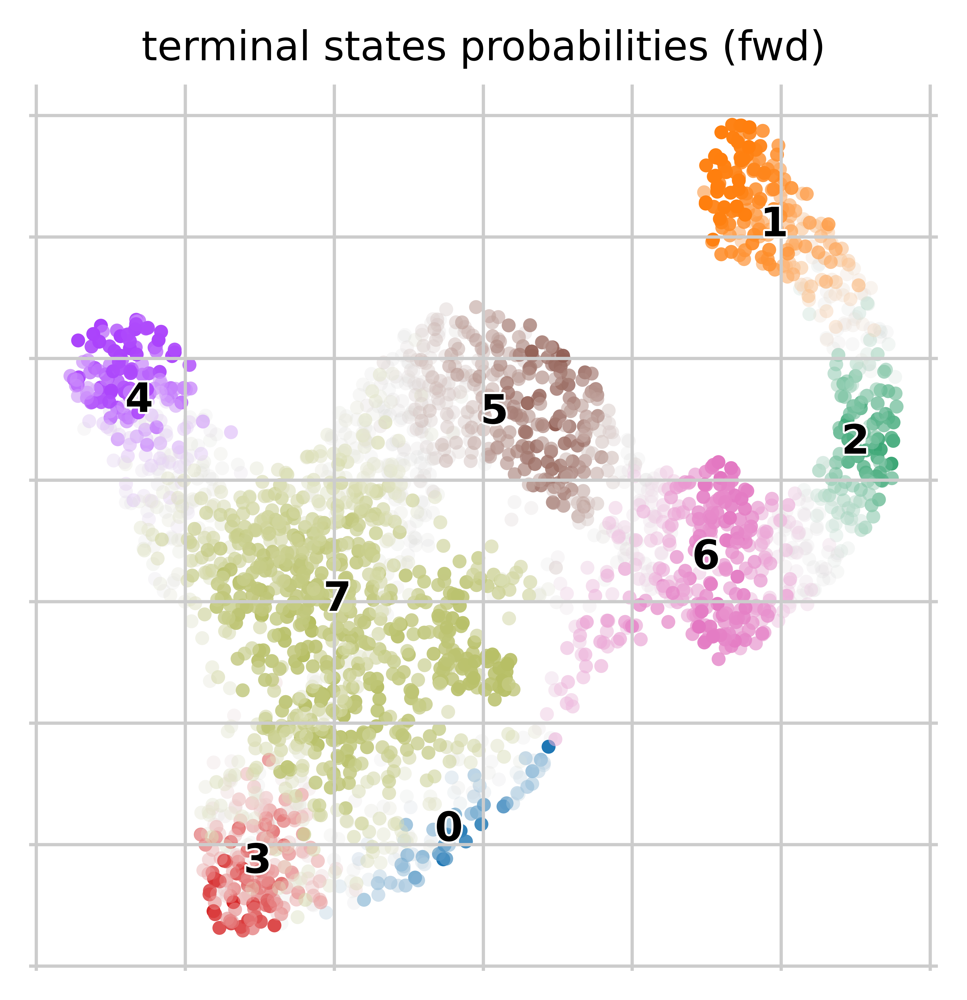

In [12]:
g.compute_terminal_states(method="top_n", n_states=8)
g.plot_terminal_states()

In [13]:
g.compute_absorption_probabilities()

  0%|          | 0/240 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://www.mcs.anl.gov/petsc/documentation/faq.html#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple Mac OS X to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


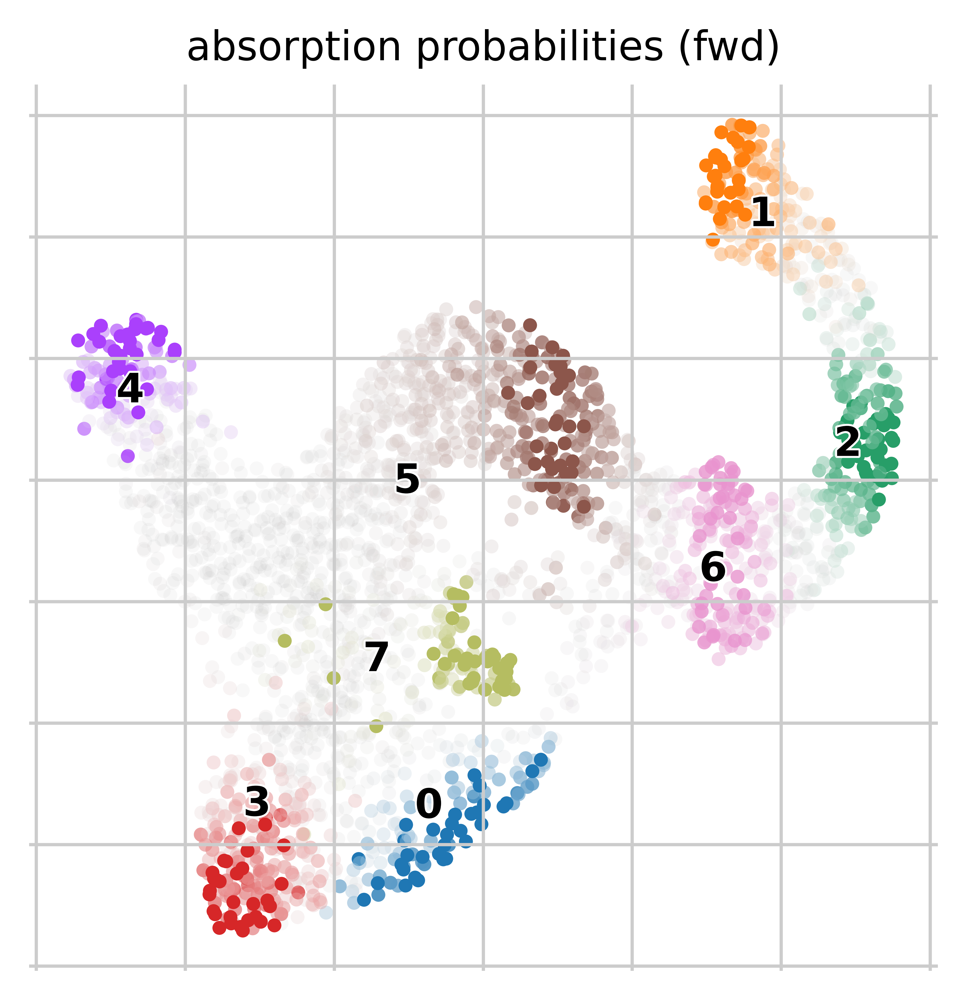

In [14]:
g.plot_absorption_probabilities(same_plot=True)

In [15]:
del adata.uns['r2_keep_train']
del adata.uns['r2_keep_test']
del adata.uns['kernel_connectivities']
del adata.uns['kernel']
adata.write('pancreas_results.h5ad')
adata_aggr.write('pancreas_results_aggr.h5ad')

In [16]:
adata = sc.read_h5ad('pancreas_results.h5ad')
adata_aggr = sc.read_h5ad('pancreas_results_aggr.h5ad')